In [1]:
# Import necessary modules for data analysis and data visualization. 
import pandas as pd
import numpy as np
import plotly.express as px
# Some visualization libraries
from matplotlib import pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')
## Some other snippit of codes to get the setting right 
import warnings ## importing warnings library. 
warnings.filterwarnings('ignore') ## Ignore warning

In [2]:
#creating a function for count of missing values and % of missing values for d1 dataframe
def missing_data(d1):
    missing_data1 = pd.DataFrame(round(d1.isnull().sum().sort_values(ascending=False)/len(d1.index)*100,2), columns=['% of missing value'])
    missing_data1['Count of Missing Values'] = d1.isnull().sum()
    return missing_data1

In [3]:
df = pd.read_csv('train-hr-analytics.csv')

In [4]:
df_test = pd.read_csv('test-hr-analytics.csv')

In [5]:
df.head()

,employee_id,department,region,education,gender,recruitment_channel,no_of_trainings,age,previous_year_rating,length_of_service,KPIs_met >80%,awards_won?,avg_training_score,is_promoted
0,65438,Sales & Marketing,region_7,Master's & above,f,sourcing,1,35,5.0,8,1,0,49,0
1,65141,Operations,region_22,Bachelor's,m,other,1,30,5.0,4,0,0,60,0
2,7513,Sales & Marketing,region_19,Bachelor's,m,sourcing,1,34,3.0,7,0,0,50,0
3,2542,Sales & Marketing,region_23,Bachelor's,m,other,2,39,1.0,10,0,0,50,0
4,48945,Technology,region_26,Bachelor's,m,other,1,45,3.0,2,0,0,73,0


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54808 entries, 0 to 54807
Data columns (total 14 columns):
employee_id             54808 non-null int64
department              54808 non-null object
region                  54808 non-null object
education               52399 non-null object
gender                  54808 non-null object
recruitment_channel     54808 non-null object
no_of_trainings         54808 non-null int64
age                     54808 non-null int64
previous_year_rating    50684 non-null float64
length_of_service       54808 non-null int64
KPIs_met >80%           54808 non-null int64
awards_won?             54808 non-null int64
avg_training_score      54808 non-null int64
is_promoted             54808 non-null int64
dtypes: float64(1), int64(8), object(5)
memory usage: 5.9+ MB


In [7]:
df.nunique()

employee_id             54808
department                  9
region                     34
education                   3
gender                      2
recruitment_channel         3
no_of_trainings            10
age                        41
previous_year_rating        5
length_of_service          35
KPIs_met >80%               2
awards_won?                 2
avg_training_score         61
is_promoted                 2
dtype: int64

In [8]:
#checking missing values
missing_data(df).head()

,% of missing value,Count of Missing Values
previous_year_rating,7.52,4124
education,4.40,2409
is_promoted,0.00,0
avg_training_score,0.00,0
awards_won?,0.00,0


In [9]:
missing_data(df_test).head()

,% of missing value,Count of Missing Values
previous_year_rating,7.71,1812
education,4.40,1034
avg_training_score,0.00,0
awards_won?,0.00,0
KPIs_met >80%,0.00,0


In [10]:
df.head()

,employee_id,department,region,education,gender,recruitment_channel,no_of_trainings,age,previous_year_rating,length_of_service,KPIs_met >80%,awards_won?,avg_training_score,is_promoted
0,65438,Sales & Marketing,region_7,Master's & above,f,sourcing,1,35,5.0,8,1,0,49,0
1,65141,Operations,region_22,Bachelor's,m,other,1,30,5.0,4,0,0,60,0
2,7513,Sales & Marketing,region_19,Bachelor's,m,sourcing,1,34,3.0,7,0,0,50,0
3,2542,Sales & Marketing,region_23,Bachelor's,m,other,2,39,1.0,10,0,0,50,0
4,48945,Technology,region_26,Bachelor's,m,other,1,45,3.0,2,0,0,73,0


In [11]:
a = df.pivot_table(index='department', columns='previous_year_rating', values='employee_id', aggfunc='count')

In [12]:
a.reset_index(inplace=True)

In [13]:
a['sum'] =  a[1.0] + a[2.0] + a[3.0] + a[4.0] + a[5.0]

In [14]:
#getting the rating percentage
li = [1.0,2.0,3.0,4.0,5.0]
for i in li:
    a[i] = a[i]/a['sum']*100
a

previous_year_rating,department,1.0,2.0,3.0,4.0,5.0,sum
0,Analytics,8.227589,5.873926,36.901351,19.934507,29.062628,4886
1,Finance,7.545495,5.503773,40.656902,21.349312,24.944518,2253
2,HR,8.011050,7.550645,38.720074,19.567219,26.151013,2172
3,Legal,10.332951,6.888634,39.494834,18.484501,24.799082,871
4,Operations,6.524164,6.208178,34.516729,23.029740,29.721190,10760
5,Procurement,10.105828,8.660009,42.972127,17.767178,20.494858,6709
6,R&D,8.114035,5.043860,38.377193,19.298246,29.166667,912
7,Sales & Marketing,19.936892,10.612403,32.603516,16.414450,20.432739,15529
8,Technology,12.697209,9.814927,41.019417,21.859830,14.608617,6592


In [15]:
df.previous_year_rating.value_counts()

3.0    18618
5.0    11741
4.0     9877
1.0     6223
2.0     4225
Name: previous_year_rating, dtype: int64

In [16]:
#as we can see most of the people got 3.0 as a rating
df['previous_year_rating'] = df['previous_year_rating'].replace(np.nan,3)

In [17]:
#as we can see most of the people got 3.0 as a rating
df_test['previous_year_rating'] = df_test['previous_year_rating'].replace(np.nan,3)

In [18]:
px.histogram(df,'education',color='gender',barmode='group', height=400, width=600)

In [19]:
df['education'] = df['education'].replace(np.nan,"Bachelor's")

In [20]:
df_test['education'] = df_test['education'].replace(np.nan,"Bachelor's")

In [21]:
missing_data(df)

,% of missing value,Count of Missing Values
is_promoted,0.0,0
avg_training_score,0.0,0
awards_won?,0.0,0
KPIs_met >80%,0.0,0
length_of_service,0.0,0
previous_year_rating,0.0,0
age,0.0,0
no_of_trainings,0.0,0
recruitment_channel,0.0,0
gender,0.0,0


In [22]:
missing_data(df_test)

,% of missing value,Count of Missing Values
avg_training_score,0.0,0
awards_won?,0.0,0
KPIs_met >80%,0.0,0
length_of_service,0.0,0
previous_year_rating,0.0,0
age,0.0,0
no_of_trainings,0.0,0
recruitment_channel,0.0,0
gender,0.0,0
education,0.0,0


In [23]:
px.histogram(df,x='education', color='gender', height=400, width=700)

In [24]:
px.histogram(df,x='education', color='is_promoted', height=400, width=700)

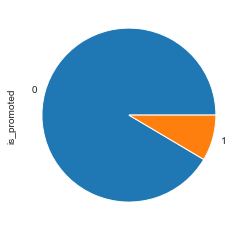

In [25]:
df.is_promoted.value_counts().plot.pie()

In [26]:
px.histogram(df,'department',color='gender',barmode='group', height=400)

In [27]:
px.histogram(df,'department',color='is_promoted', height=400)

In [28]:
px.box(df,y='age', height=400, color='is_promoted', width=600)

In [29]:
px.histogram(df,'region',color='is_promoted',barmode='group', height=400)

In [30]:
px.histogram(df,'recruitment_channel',color='is_promoted',barmode='group', height=400)

In [31]:
px.box(df,y='no_of_trainings', height=400, color='is_promoted', width=600)

In [32]:
px.box(df,y='length_of_service', height=400, color='is_promoted', width=600)

In [33]:
px.box(df,y='avg_training_score', height=400, color='is_promoted', width=600)

In [34]:
df.region = df.region.apply(lambda x : x.split('_')[1])

In [35]:
df.region = df.region.astype('int')

In [36]:
df.gender = df.gender.map({'m':1,'f':0})

In [37]:
aa = pd.get_dummies(df[['education','recruitment_channel']],drop_first=True)

In [38]:
df = pd.concat([df,aa],axis=1)

In [39]:
df.drop(['education','recruitment_channel'],axis=1, inplace=True)

In [40]:
df_test.region = df_test.region.apply(lambda x : x.split('_')[1])
df_test.region = df_test.region.astype('int')
df_test.gender = df_test.gender.map({'m':1,'f':0})
bb = pd.get_dummies(df_test[['education','recruitment_channel']],drop_first=True)
df_test = pd.concat([df_test,bb],axis=1)
df_test.drop(['education','recruitment_channel'],axis=1, inplace=True)

In [41]:
df.columns

Index(['employee_id', 'department', 'region', 'gender', 'no_of_trainings',
       'age', 'previous_year_rating', 'length_of_service', 'KPIs_met >80%',
       'awards_won?', 'avg_training_score', 'is_promoted',
       'education_Below Secondary', 'education_Master's & above',
       'recruitment_channel_referred', 'recruitment_channel_sourcing'],
      dtype='object')

In [42]:
df_test.columns

Index(['employee_id', 'department', 'region', 'gender', 'no_of_trainings',
       'age', 'previous_year_rating', 'length_of_service', 'KPIs_met >80%',
       'awards_won?', 'avg_training_score', 'education_Below Secondary',
       'education_Master's & above', 'recruitment_channel_referred',
       'recruitment_channel_sourcing'],
      dtype='object')

In [43]:
df.head()

,employee_id,department,region,gender,no_of_trainings,age,previous_year_rating,length_of_service,KPIs_met >80%,awards_won?,avg_training_score,is_promoted,education_Below Secondary,education_Master's & above,recruitment_channel_referred,recruitment_channel_sourcing
0,65438,Sales & Marketing,7,0,1,35,5.0,8,1,0,49,0,0,1,0,1
1,65141,Operations,22,1,1,30,5.0,4,0,0,60,0,0,0,0,0
2,7513,Sales & Marketing,19,1,1,34,3.0,7,0,0,50,0,0,0,0,1
3,2542,Sales & Marketing,23,1,2,39,1.0,10,0,0,50,0,0,0,0,0
4,48945,Technology,26,1,1,45,3.0,2,0,0,73,0,0,0,0,0


In [44]:
df_test.head()

,employee_id,department,region,gender,no_of_trainings,age,previous_year_rating,length_of_service,KPIs_met >80%,awards_won?,avg_training_score,education_Below Secondary,education_Master's & above,recruitment_channel_referred,recruitment_channel_sourcing
0,8724,Technology,26,1,1,24,3.0,1,1,0,77,0,0,0,1
1,74430,HR,4,0,1,31,3.0,5,0,0,51,0,0,0,0
2,72255,Sales & Marketing,13,1,1,31,1.0,4,0,0,47,0,0,0,0
3,38562,Procurement,2,0,3,31,2.0,9,0,0,65,0,0,0,0
4,64486,Finance,29,1,1,30,4.0,7,0,0,61,0,0,0,1


In [45]:
#importing the necessary libraries
from sklearn.preprocessing import LabelEncoder

#getting categorical variables
cat_feat = list(df.dtypes[df.dtypes == 'object'].index)

#Encoding the categorical variables
for c in cat_feat:
    lbl = LabelEncoder() 
    lbl.fit(list(df[c].values)) 
    df[c] = lbl.transform(list(df[c].values))

In [46]:
cat_feat

['department']

In [47]:
#getting categorical variables
cat_feat = list(df_test.dtypes[df_test.dtypes == 'object'].index)

#Encoding the categorical variables
for c in cat_feat:
    lbl = LabelEncoder() 
    lbl.fit(list(df_test[c].values)) 
    df_test[c] = lbl.transform(list(df_test[c].values))

In [48]:
df.drop('employee_id',axis=1, inplace=True)

In [49]:
df_test.drop('employee_id',axis=1, inplace=True)

In [50]:
df.gender.value_counts()

1    38496
0    16312
Name: gender, dtype: int64

In [51]:
from sklearn.model_selection import train_test_split

In [52]:
df_train, df_test0 = train_test_split(df, test_size=0.3, random_state=42)
print(df_train.shape)
print(df_test0.shape)

(38365, 15)
(16443, 15)


In [53]:
# divide into X_train, y_train, X_test, y_test
y_train = df_train.pop('is_promoted')
X_train = df_train

y_test = df_test0.pop('is_promoted')
X_test = df_test0

In [54]:
# Algorithms 
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
import xgboost as xgb
from xgboost import XGBClassifier
from xgboost import plot_importance

# Model evaluation libraries
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_curve
from sklearn import metrics
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import StratifiedKFold


In [55]:
# creating a function for gridsearch which can be used various models

# Create a function gridsearch which would be used for fine tuning hyper-parameters
def gridsearch_classifier(estimator, params, score, X_train, y_train, refit_score):
    kfolds = StratifiedKFold(n_splits = 3, shuffle = True, random_state = 16)
    grid_search = GridSearchCV(estimator, params, scoring = score, refit = refit_score, cv = kfolds, return_train_score = True, n_jobs = - 1, verbose=2)
    grid_search.fit(X_train, y_train)
    print(grid_search.best_params_)
    cv_results = grid_search.cv_results_
    cv_results = pd.DataFrame(cv_results)
    return cv_results

def randsearch_classifier(estimator, params, score, X_train, y_train, refit_score):
    kfolds = StratifiedKFold(n_splits = 3, shuffle = True, random_state = 16)
    rand_search = RandomizedSearchCV(estimator, params, scoring = score, cv = kfolds, refit = refit_score, return_train_score = True, n_jobs = - 1, verbose=2)
    rand_search.fit(X_train, y_train)
    print(rand_search.best_params_)
    cv_results = rand_search.cv_results_
    cv_results = pd.DataFrame(cv_results)
    return cv_results

# Creating a function for metrics, confusion matrix and classification report 
def classification_rep(y_train, X_train, model):
    probs = np.array([x[-1] for x in model.predict_proba(X_train)])
    print('The roc_auc score is {}'.format(roc_auc_score(y_train, probs).round(4)))
    print('confusion matrix:')
    print(confusion_matrix(y_train, model.predict(X_train)))
    print('classification report:')
    print(classification_report(y_train, model.predict(X_train)))
    
# Creating a function metrics_curve for drawing ROC_curve and 
def metrics_curves(y_train, X_train, model):  
    
    probs = np.array([x[-1] for x in model.predict_proba(X_train)])
    fpr, tpr, thresholds = roc_curve( y_train, probs)
    auc_score = roc_auc_score( y_train, probs )
    plt.figure(figsize=(8, 8))
    plt.plot( fpr, tpr, label='ROC curve (area = %0.2f)' % auc_score )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()
    
    
    p, r, thresholds = precision_recall_curve(y_train, probs)
    pre_recal = pd.DataFrame({'precision':p[:-1], 'recall':r[:-1], 'thresholds': thresholds})
    pre_recal.plot.line(x='thresholds', y=['precision','recall'], figsize = (8,8))
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.title('Precision vs Recall Trade-Off Curve')
    plt.show()

# creating function for evaluating cross validation score on oversampled train dataset using SMOTE
def repeated_evaluation_smote(model, X_train, y_train):
    rskf = RepeatedStratifiedKFold(n_splits=5, n_repeats=1, random_state=0)
    X_trainr = X_train.copy()
    X_trainr = X_trainr.reset_index()
    X_trainr = X_trainr.drop('index', axis = 1)
    
    y_trainr = y_train.copy()
    y_trainr = y_train.reset_index()
    y_trainr = y_trainr.drop('index', axis = 1)
    y_trainr = y_trainr['is_promoted']
    train_auc_scores = []
    test_auc_scores = []
    train_pr_scores = []
    test_pr_scores = []
    train_re_scores = []
    test_re_scores = []
    train_acc_scores = []
    test_acc_scores = []
    for train_index, test_index in rskf.split(X_trainr, y_trainr):
        d_Xtrain, d_Xtest = X_trainr.loc[train_index, ], X_trainr.loc[test_index,]
        d_ytrain, d_ytest = y_trainr.loc[train_index,], y_trainr.loc[test_index,]
        
        d_smt = SMOTE(random_state = 0, n_jobs = -1)
        d_Xtrain_smt, d_ytrain_smt = d_smt.fit_sample(d_Xtrain, d_ytrain)

        model.fit(d_Xtrain_smt, d_ytrain_smt)
        train_auc_scores.append(roc_auc_score(d_ytrain_smt, (model.predict_proba(d_Xtrain_smt)[:,1])))
        test_auc_scores.append(roc_auc_score(d_ytest, (model.predict_proba(d_Xtest)[:,1])))
        train_pr_scores.append(metrics.precision_score(d_ytrain_smt, (model.predict(d_Xtrain_smt))))
        test_pr_scores.append(metrics.precision_score(d_ytest, (model.predict(d_Xtest))))
        train_re_scores.append(metrics.recall_score(d_ytrain_smt, (model.predict(d_Xtrain_smt))))
        test_re_scores.append((metrics.recall_score(d_ytest, (model.predict(d_Xtest)))))
        train_acc_scores.append(metrics.accuracy_score(d_ytrain_smt, (model.predict(d_Xtrain_smt))))
        test_acc_scores.append(metrics.accuracy_score(d_ytest, (model.predict(d_Xtest))))
                           
    results = pd.DataFrame({'train_auc_scores': train_auc_scores, 'test_auc_scores': test_auc_scores, 
                           'train_pr_scores': train_pr_scores, 'test_pr_scores': test_pr_scores,
                           'train_re_scores': train_re_scores, 'test_re_scores': test_re_scores,
                           'train_acc_scores': train_acc_scores, 'test_acc_scores': test_acc_scores,})
    return results

In [56]:

def plot_results(df_results, param, score):
    plt.figure(figsize= (8,6))
    plt.plot(df_results[param], df_results[score])
#     plt.plot(df_results[param], df_results['mean_train_score'], 'bo-')
    plt.title('{} vs {}'.format(score, param))
    plt.xlabel(param)
    plt.ylabel(score)
    plt.show()

## Modelling

### Logistic Regression

The roc_auc score is 0.8063
confusion matrix:
[[25179  9851]
 [  944  2391]]
classification report:
              precision    recall  f1-score   support

         0.0       0.96      0.72      0.82     35030
         1.0       0.20      0.72      0.31      3335

    accuracy                           0.72     38365
   macro avg       0.58      0.72      0.57     38365
weighted avg       0.90      0.72      0.78     38365



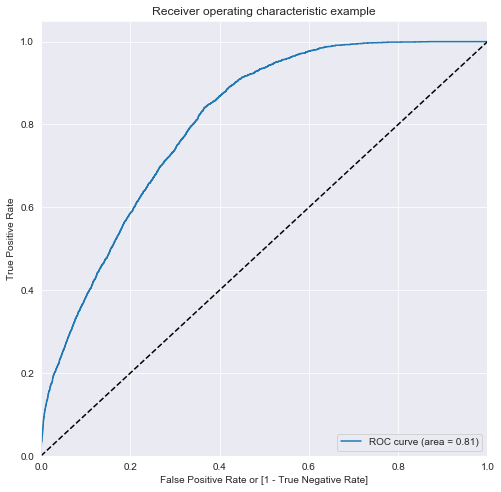

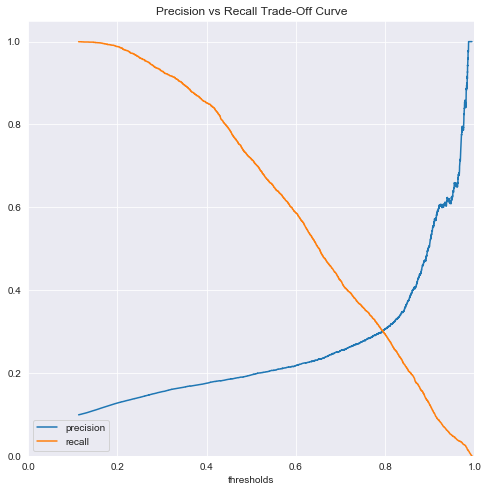

In [47]:
# Creating logistic model with class_weight = balanced
log_m = LogisticRegression(random_state = 0, n_jobs = -1, class_weight= 'balanced')
log_m.fit(X_train, y_train)

# identifying metrics for the train dataset
classification_rep(y_train, X_train, log_m)
metrics_curves(y_train, X_train, log_m)

### Logistic with Hyper parameter

In [169]:
##- Hyper-parametr tuning using gridsearch- penalty (regularization) and C - regularization

lr_m = LogisticRegression(random_state = 0, n_jobs = -1)
#param grid for gridsearch
params = {'penalty' : ['l1', 'l2'], 'C':[0.0001, 0.001, 0.01, 0.1, 1, 10, 100], 
          'class_weight': ['balanced', {0:1, 1:1}, {0:1, 1:5}, {0:1, 1:5}, {0:1, 1:10},{0:1, 1:50}, {0:1,1:100}]}

# using the gridsearch function created for grid search and tuning hyper parameter
cv_results = gridsearch_classifier(lr_m, params, ['recall', 'accuracy', 'precision', 'roc_auc', 'f1'], X_train, y_train, 'f1')
cv_results[['param_C', 'param_penalty', 'param_class_weight',
            'mean_test_recall', 'mean_test_accuracy', 'mean_test_precision', 
            'mean_test_roc_auc', 'mean_test_f1']].sort_values(by = 'mean_test_f1', ascending = False).head(10)

Fitting 3 folds for each of 98 candidates, totalling 294 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    7.4s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:   18.7s
[Parallel(n_jobs=-1)]: Done 294 out of 294 | elapsed:   38.4s finished


{'C': 10, 'class_weight': {0: 1, 1: 5}, 'penalty': 'l1'}


,param_C,param_penalty,param_class_weight,mean_test_recall,mean_test_accuracy,mean_test_precision,mean_test_roc_auc,mean_test_f1
76,10,l1,"{0: 1, 1: 5}",0.435089,0.837404,0.250231,0.805626,0.317701
74,10,l1,"{0: 1, 1: 5}",0.435089,0.837404,0.250231,0.805626,0.317701
75,10,l2,"{0: 1, 1: 5}",0.435089,0.837352,0.250151,0.805632,0.317635
77,10,l2,"{0: 1, 1: 5}",0.435089,0.837352,0.250151,0.805632,0.317635
60,1,l1,"{0: 1, 1: 5}",0.434489,0.837534,0.250282,0.805637,0.317581
62,1,l1,"{0: 1, 1: 5}",0.434489,0.837534,0.250282,0.805637,0.317581
91,100,l2,"{0: 1, 1: 5}",0.435089,0.837300,0.250055,0.805628,0.317560
90,100,l1,"{0: 1, 1: 5}",0.435089,0.837300,0.250055,0.805628,0.317560
89,100,l2,"{0: 1, 1: 5}",0.435089,0.837300,0.250055,0.805628,0.317560
88,100,l1,"{0: 1, 1: 5}",0.435089,0.837300,0.250055,0.805628,0.317560


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    1.0s remaining:    1.5s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    1.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    0.9s remaining:    1.5s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    1.0s finished


The Cross-validation auc score mean on train dataset is 0.8055
The Cross-validation auc score std on train dataset is 0.0069
The Cross-validation f1score mean on train dataset is 0.3188
The Cross-validation f1score std on train dataset is 0.013
---------Train Data Metrics------------
The roc_auc score is 0.8063
confusion matrix:
[[30670  4360]
 [ 1870  1465]]
classification report:
              precision    recall  f1-score   support

         0.0       0.94      0.88      0.91     35030
         1.0       0.25      0.44      0.32      3335

    accuracy                           0.84     38365
   macro avg       0.60      0.66      0.61     38365
weighted avg       0.88      0.84      0.86     38365



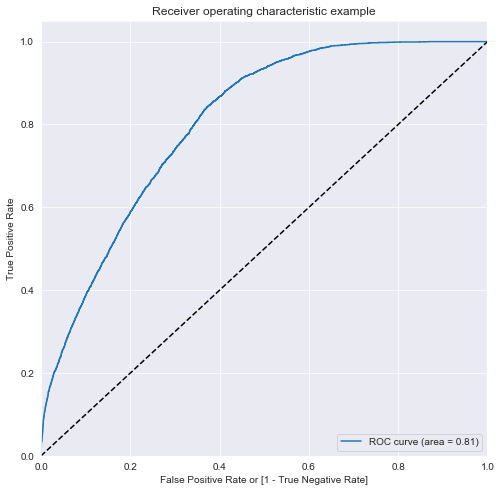

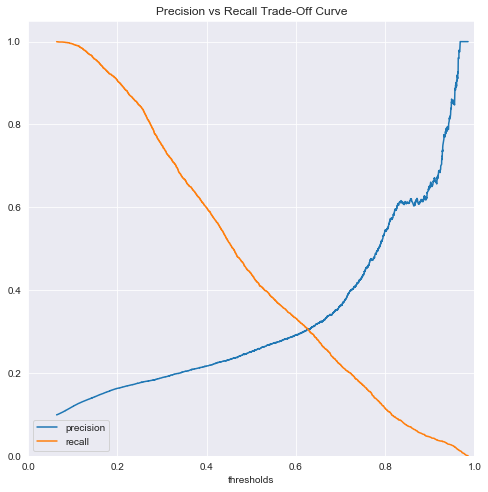

In [170]:
# Finalizing the model based on the hyper parameter tuned above
log_m = LogisticRegression(C = 10, penalty = 'l1', n_jobs = -1, class_weight= {0:1,1:5}, random_state = 0)
log_m.fit(X_train, y_train)

# cross validation roc_auc score for the train data
cv_auc_score = cross_val_score(log_m, X_train, y_train, scoring= 'roc_auc', cv = 5, n_jobs = -1, verbose = 1)
cv_f1_score = cross_val_score(log_m, X_train, y_train, scoring= 'f1', cv = 5, n_jobs = -1, verbose = 1)
print('The Cross-validation auc score mean on train dataset is {}'.format(cv_auc_score.mean().round(4)))
print('The Cross-validation auc score std on train dataset is {}'.format(cv_auc_score.std().round(4)))
print('The Cross-validation f1score mean on train dataset is {}'.format(cv_f1_score.mean().round(4)))
print('The Cross-validation f1score std on train dataset is {}'.format(cv_f1_score.std().round(4)))
# metrics for the train data
print('---------Train Data Metrics------------')
classification_rep(y_train, X_train, log_m)
metrics_curves(y_train, X_train, log_m)

In [171]:
# evaluation on test dataset
classification_rep(y_test, X_test, log_m)

The roc_auc score is 0.812
confusion matrix:
[[13242  1868]
 [  726   607]]
classification report:
              precision    recall  f1-score   support

         0.0       0.95      0.88      0.91     15110
         1.0       0.25      0.46      0.32      1333

    accuracy                           0.84     16443
   macro avg       0.60      0.67      0.61     16443
weighted avg       0.89      0.84      0.86     16443



### SMOTE

In [172]:
from imblearn.over_sampling import SMOTE

# using SMOTE to oversample and produce a balance datase
smt = SMOTE(random_state = 0, n_jobs = -1)
X_train_smt, y_train_smt = smt.fit_sample(X_train, y_train)

print(y_train.value_counts())
np.unique(y_train_smt, return_counts=True)

0.0    35030
1.0     3335
Name: is_promoted, dtype: int64


(array([0., 1.]), array([35030, 35030], dtype=int64))

### Logistic with SMOTE

The roc_auc score is 0.811
confusion matrix:
[[25250  9780]
 [ 9696 25334]]
classification report:
              precision    recall  f1-score   support

         0.0       0.72      0.72      0.72     35030
         1.0       0.72      0.72      0.72     35030

    accuracy                           0.72     70060
   macro avg       0.72      0.72      0.72     70060
weighted avg       0.72      0.72      0.72     70060



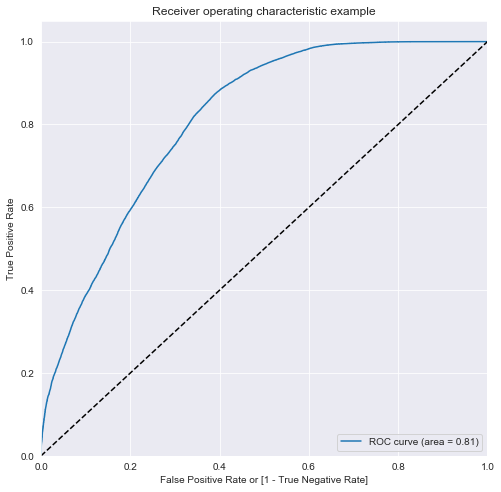

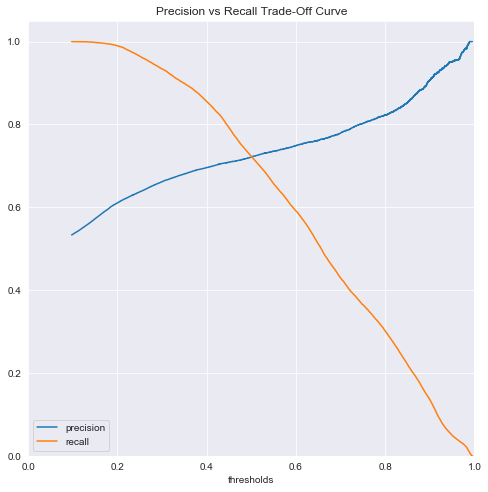

In [173]:
# Creating logistic model with class_weight = balanced
log_m_smt = LogisticRegression(random_state = 0, n_jobs = -1)
log_m_smt.fit(X_train_smt, y_train_smt)

# metrics on the oversampled train dataset
classification_rep(y_train_smt, X_train_smt, log_m_smt)
metrics_curves(y_train_smt, X_train_smt, log_m_smt)

### Logistic with SMOTE with hyper paramter tuning 

In [174]:
#- Hyper-parametr tuning using gridsearch- penalty (regularization) and C - regularization
lr_m = LogisticRegression(random_state = 0, n_jobs = -1)
params = {'penalty' : ['l1', 'l2'], 'C':[0.00001, 0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000], 'class_weight': 
          ['balanced', {0:1, 1:1}, {0:1, 1:5}, {0:1, 1:5}, {0:1, 1:10}, {0:1, 1:50}, {0:1,1:100}]}

# using the gridsearch function created for grid search and tuning hyper parameter
cv_results = gridsearch_classifier(lr_m, params, ['recall', 'accuracy', 'precision', 'roc_auc', 'f1'], X_train_smt, y_train_smt, 'f1')
cv_results[['param_C', 'param_penalty', 'mean_test_recall',
            'param_class_weight', 'mean_test_accuracy', 'mean_test_precision', 'mean_test_roc_auc', 
            'mean_test_f1']].sort_values(by = 'mean_test_f1', ascending = False).head(10)

Fitting 3 folds for each of 126 candidates, totalling 378 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:   18.5s
[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 378 out of 378 | elapsed:  1.2min finished


{'C': 100, 'class_weight': {0: 1, 1: 5}, 'penalty': 'l2'}


,param_C,param_penalty,mean_test_recall,param_class_weight,mean_test_accuracy,mean_test_precision,mean_test_roc_auc,mean_test_f1
105,100,l2,0.988496,"{0: 1, 1: 5}",0.687896,0.617347,0.809725,0.760031
119,1000,l2,0.988496,"{0: 1, 1: 5}",0.687896,0.617347,0.809725,0.760031
117,1000,l2,0.988496,"{0: 1, 1: 5}",0.687896,0.617347,0.809725,0.760031
103,100,l2,0.988496,"{0: 1, 1: 5}",0.687896,0.617347,0.809725,0.760031
89,10,l2,0.988524,"{0: 1, 1: 5}",0.687853,0.617310,0.809719,0.760011
91,10,l2,0.988524,"{0: 1, 1: 5}",0.687853,0.617310,0.809719,0.760011
77,1,l2,0.988667,"{0: 1, 1: 5}",0.687668,0.617146,0.809723,0.759929
75,1,l2,0.988667,"{0: 1, 1: 5}",0.687668,0.617146,0.809723,0.759929
76,1,l1,0.988752,"{0: 1, 1: 5}",0.687482,0.616991,0.809726,0.759836
74,1,l1,0.988752,"{0: 1, 1: 5}",0.687482,0.616991,0.809726,0.759836


The roc_auc score is 0.8099
confusion matrix:
[[13555 21475]
 [  399 34631]]
classification report:
              precision    recall  f1-score   support

         0.0       0.97      0.39      0.55     35030
         1.0       0.62      0.99      0.76     35030

    accuracy                           0.69     70060
   macro avg       0.79      0.69      0.66     70060
weighted avg       0.79      0.69      0.66     70060



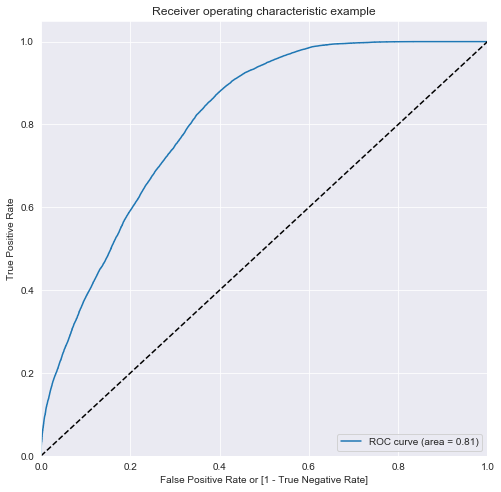

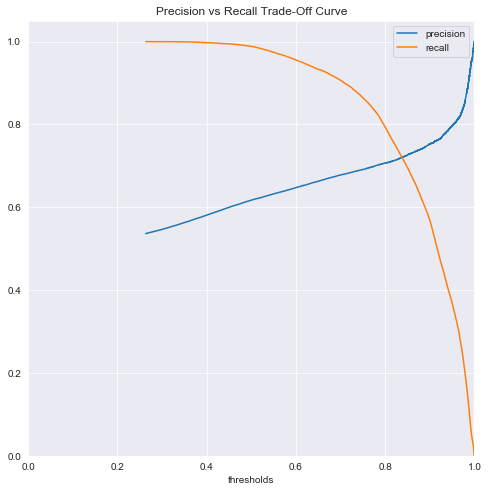

In [175]:
# Finalizing the model based on above hyper parameter tuning
log_m_smt = LogisticRegression(C = 100, penalty = 'l2',class_weight={0: 1, 1: 5}, random_state = 0, n_jobs = -1)
log_m_smt.fit(X_train_smt, y_train_smt)

# revised metrics on the oversampled train dataset
classification_rep(y_train_smt, X_train_smt, log_m_smt)
metrics_curves(y_train_smt, X_train_smt, log_m_smt)

In [176]:
# Based on the function created for cross-validation smote
results = repeated_evaluation_smote(log_m_smt, X_train, y_train)
results.mean(), results.std()

(train_auc_scores    0.809579
 test_auc_scores     0.803438
 train_pr_scores     0.617472
 test_pr_scores      0.132351
 train_re_scores     0.988431
 test_re_scores      0.981409
 train_acc_scores    0.688042
 test_acc_scores     0.439072
 dtype: float64, train_auc_scores    0.001638
 test_auc_scores     0.002610
 train_pr_scores     0.001097
 test_pr_scores      0.000893
 train_re_scores     0.000979
 test_re_scores      0.004812
 train_acc_scores    0.001242
 test_acc_scores     0.006077
 dtype: float64)

In [177]:
# Evaluating the model on test dataset
classification_rep(y_test, X_test, log_m_smt)

The roc_auc score is 0.8093
confusion matrix:
[[5776 9334]
 [  31 1302]]
classification report:
              precision    recall  f1-score   support

         0.0       0.99      0.38      0.55     15110
         1.0       0.12      0.98      0.22      1333

    accuracy                           0.43     16443
   macro avg       0.56      0.68      0.38     16443
weighted avg       0.92      0.43      0.53     16443



### Random Forest

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  40 out of  40 | elapsed:    0.2s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  40 out of  40 | elapsed:    0.0s finished


The roc_auc score is 0.9053
confusion matrix:


[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  40 out of  40 | elapsed:    0.0s finished


[[35028     2]
 [ 2751   584]]
classification report:


[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  40 out of  40 | elapsed:    0.0s finished


              precision    recall  f1-score   support

         0.0       0.93      1.00      0.96     35030
         1.0       1.00      0.18      0.30      3335

    accuracy                           0.93     38365
   macro avg       0.96      0.59      0.63     38365
weighted avg       0.93      0.93      0.90     38365



[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  40 out of  40 | elapsed:    0.0s finished


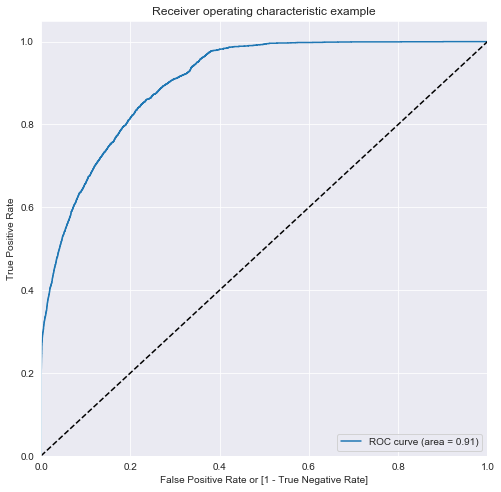

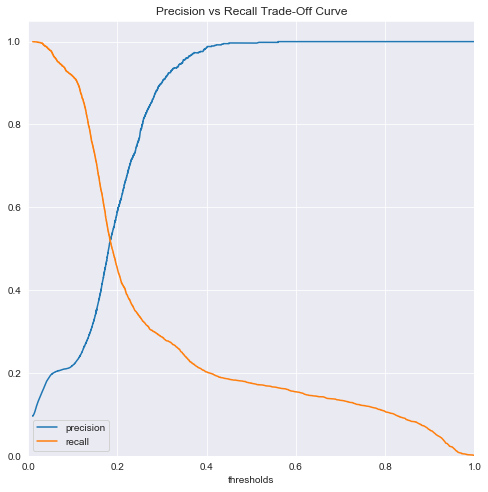

In [48]:
# using a base model with 40 trees
rf_m = RandomForestClassifier(n_estimators = 40, max_depth =10, n_jobs = -1, random_state = 0, oob_score= True, verbose = 1)
rf_m.fit(X_train, y_train)

classification_rep(y_train, X_train, rf_m)
results_df = metrics_curves(y_train, X_train, rf_m)
results_df

### Random Forest with hyper parameter tuning

In [49]:
# Tuning hyper parameters - Tuning n_estimators, max_depth, min_samples split and max_features
rf_m = RandomForestClassifier(random_state = 0, n_jobs = -1, class_weight= 'balanced', verbose=1, oob_score = True)
params_rf = {'min_samples_split' : [20,50,100,150],
             'min_samples_leaf' : [20,50,100,150],
             'n_estimators' : [100,200,300], 
             'max_depth' : [5,10,12], 
             'max_features' : ['auto', 0.2, 0.5, 0.8]}

# using the rand search for identifying best parameters
cv_results = randsearch_classifier(rf_m, params_rf, ['recall', 'accuracy', 'precision', 'roc_auc', 'f1'], X_train, y_train, 'roc_auc')
cv_results[cv_results['rank_test_roc_auc'] == 1]

Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed:  1.4min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed:    2.6s finished


{'n_estimators': 200, 'min_samples_split': 100, 'min_samples_leaf': 20, 'max_features': 0.8, 'max_depth': 12}


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,param_min_samples_split,param_min_samples_leaf,param_max_features,param_max_depth,params,...,split1_test_f1,split2_test_f1,mean_test_f1,std_test_f1,rank_test_f1,split0_train_f1,split1_train_f1,split2_train_f1,mean_train_f1,std_train_f1
9,9.173916,0.207382,2.678028,1.185946,200,100,20,0.8,12,"{'n_estimators': 200, 'min_samples_split': 100...",...,0.376754,0.380714,0.37795,0.00196,1,0.415621,0.412761,0.406377,0.411586,0.003864


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed:    4.0s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 200 out of 200 | elapsed:    0.2s finished


The roc_auc score is 0.9253
confusion matrix:


[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 200 out of 200 | elapsed:    0.2s finished


[[34929   101]
 [ 2366   969]]
classification report:


[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 200 out of 200 | elapsed:    0.2s finished


              precision    recall  f1-score   support

         0.0       0.94      1.00      0.97     35030
         1.0       0.91      0.29      0.44      3335

    accuracy                           0.94     38365
   macro avg       0.92      0.64      0.70     38365
weighted avg       0.93      0.94      0.92     38365



[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 200 out of 200 | elapsed:    0.2s finished


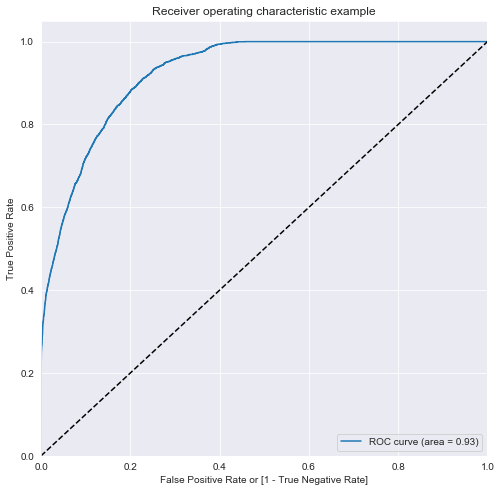

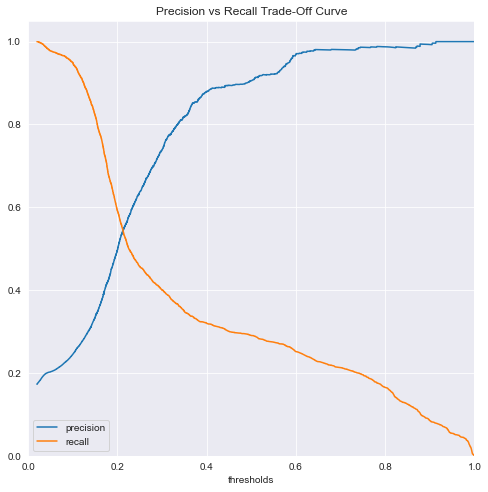

In [50]:
# using a model with results from randsearch
rf_m = RandomForestClassifier(n_estimators= 200, min_samples_split =100, min_samples_leaf= 20, 
                              max_features = 0.8, max_depth= 12, n_jobs = -1, random_state = 0, oob_score= True, verbose = 1)
rf_m.fit(X_train, y_train)

classification_rep(y_train, X_train, rf_m)
results_df = metrics_curves(y_train, X_train, rf_m)
results_df

In [53]:
#fine tuning - Tuning n_estimators, max_depth, min_samples split and max_features
rf_m = RandomForestClassifier(random_state = 0, n_jobs = -1, class_weight= 'balanced', verbose=1, oob_score = True)
params_rf = {'min_samples_split' : [90,100,110],
             'min_samples_leaf' : [5,15,50],
             'n_estimators' : [150,200,250], 
             'max_depth' : [10,15,20], 
             'max_features' : [0.6,0.8,0.9]}

# using the gridsearch for identifying best parameters
cv_results = gridsearch_classifier(rf_m, params_rf, ['recall', 'accuracy', 'precision', 'roc_auc', 'f1'], X_train, y_train, 'roc_auc')
cv_results[cv_results['rank_test_roc_auc'] == 1]

Fitting 3 folds for each of 243 candidates, totalling 729 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:  9.0min
[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed: 17.9min
[Parallel(n_jobs=-1)]: Done 632 tasks      | elapsed: 33.4min
[Parallel(n_jobs=-1)]: Done 729 out of 729 | elapsed: 38.0min finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 250 out of 250 | elapsed:    3.5s finished


{'max_depth': 20, 'max_features': 0.9, 'min_samples_leaf': 5, 'min_samples_split': 90, 'n_estimators': 250}


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_max_features,param_min_samples_leaf,param_min_samples_split,param_n_estimators,params,...,split1_test_f1,split2_test_f1,mean_test_f1,std_test_f1,rank_test_f1,split0_train_f1,split1_train_f1,split2_train_f1,mean_train_f1,std_train_f1
218,12.877261,0.463311,4.839419,0.051343,20,0.9,5,90,250,"{'max_depth': 20, 'max_features': 0.9, 'min_sa...",...,0.406741,0.408117,0.406179,0.001855,5,0.489289,0.479862,0.468792,0.479315,0.008377


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed:    4.6s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 200 out of 200 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.


The roc_auc score is 0.9376
confusion matrix:


[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 200 out of 200 | elapsed:    0.3s finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.


[[34938    92]
 [ 2283  1052]]
classification report:


[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 200 out of 200 | elapsed:    0.3s finished


              precision    recall  f1-score   support

           0       0.94      1.00      0.97     35030
           1       0.92      0.32      0.47      3335

    accuracy                           0.94     38365
   macro avg       0.93      0.66      0.72     38365
weighted avg       0.94      0.94      0.92     38365



[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.0s
[Parallel(n_jobs=8)]: Done 184 tasks      | elapsed:    0.2s
[Parallel(n_jobs=8)]: Done 200 out of 200 | elapsed:    0.3s finished


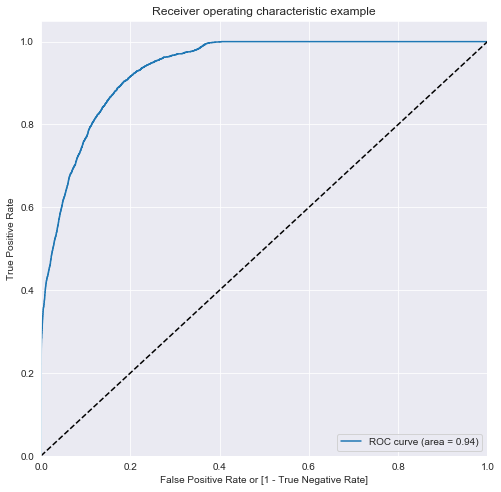

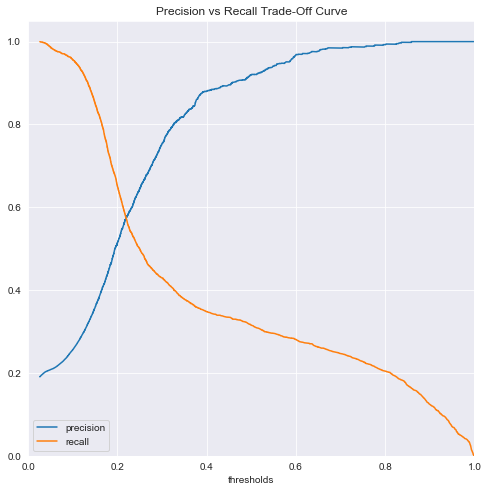

In [158]:
# using a model with results from randsearch
rf_m = RandomForestClassifier(n_estimators= 200, min_samples_split =100, min_samples_leaf= 5, 
                              max_features = 0.8, max_depth= 15, n_jobs = -1, random_state = 0, oob_score= True, verbose = 1)
rf_m.fit(X_train, y_train)

classification_rep(y_train, X_train, rf_m)
results_df = metrics_curves(y_train, X_train, rf_m)
results_df

### XGBoost

In [66]:
# initiating the base model which would be used for reference 
xgb5 = XGBClassifier( learning_rate =0.1, n_estimators=200, max_depth=5, min_child_weight=1, gamma=0,subsample=0.8, colsample_bytree=0.8,
                     objective= 'binary:logistic', scale_pos_weight=1, random_state=0, n_jobs = -1, verbosity = 0)
xgb5.fit(X_train, y_train)
classification_rep(y_train, X_train, xgb5)
classification_rep(y_test, X_test, xgb5)

The roc_auc score is 0.9459
confusion matrix:
[[34997    33]
 [ 2117  1218]]
classification report:
              precision    recall  f1-score   support

           0       0.94      1.00      0.97     35030
           1       0.97      0.37      0.53      3335

    accuracy                           0.94     38365
   macro avg       0.96      0.68      0.75     38365
weighted avg       0.95      0.94      0.93     38365

The roc_auc score is 0.9101
confusion matrix:
[[15081    29]
 [  867   466]]
classification report:
              precision    recall  f1-score   support

           0       0.95      1.00      0.97     15110
           1       0.94      0.35      0.51      1333

    accuracy                           0.95     16443
   macro avg       0.94      0.67      0.74     16443
weighted avg       0.95      0.95      0.93     16443



In [68]:
# Tuning max_depth and min_child_weight parameters
params = {'max_depth':range(3,10,2),'min_child_weight':range(1,6,2)}

grid_search = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=200, max_depth=5,
                                                  min_child_weight=1, gamma=0, subsample=0.8, colsample_bytree=0.8,
                                                  objective= 'binary:logistic', n_jobs=-1, scale_pos_weight=1, random_state=0), 
                        param_grid = params, scoring='f1',cv=5, n_jobs = -1, return_train_score = True, verbose = 2)
grid_search.fit(X_train,y_train)
final_cv_results = grid_search.cv_results_
final_cv_results = pd.DataFrame(final_cv_results)
final_cv_results[final_cv_results['rank_test_score'] == 1]

Fitting 5 folds for each of 12 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:   52.1s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:  2.4min finished


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_min_child_weight,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
8,19.494498,0.206552,0.251977,0.071638,7,5,"{'max_depth': 7, 'min_child_weight': 5}",0.526882,0.517572,0.501075,...,0.503648,0.022895,1,0.570296,0.574822,0.582086,0.57226,0.589369,0.577767,0.007044


In [69]:
# Further fine tuning max_depth and min_child_weight 
params = { 'max_depth':[6,7,8,9],'min_child_weight':[3,4,5,6,7,8]}

xgb = XGBClassifier( learning_rate =0.1, n_estimators=200, max_depth=7,
                    min_child_weight=5, gamma=0, subsample=0.8, colsample_bytree=0.8,
                    objective= 'binary:logistic', n_jobs=-1, scale_pos_weight=1, random_state=27)

grid_search = GridSearchCV(estimator = xgb,
                           param_grid = params, 
                           scoring='f1',
                           cv=5, 
                           n_jobs = -1, 
                           return_train_score = True, 
                           verbose = 2)

grid_search.fit(X_train,y_train)
final_cv_results = grid_search.cv_results_
final_cv_results = pd.DataFrame(final_cv_results)
final_cv_results[final_cv_results['rank_test_score'] == 1]

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:  5.0min finished


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_min_child_weight,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
7,20.025024,0.29953,0.14067,0.044429,7,4,"{'max_depth': 7, 'min_child_weight': 4}",0.532909,0.513312,0.505353,...,0.506496,0.021014,1,0.585954,0.584164,0.589005,0.581837,0.600829,0.588358,0.006661


In [71]:
# Identifying right gamma for the model
params = {'gamma':[i/10.0 for i in range(0,11)]}

grid_search = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=200, max_depth=7,
                                                  min_child_weight=4, gamma=0, subsample=0.8, colsample_bytree=0.8,
                                                  objective= 'binary:logistic', n_jobs=-1, scale_pos_weight=1, random_state=27), 
                        param_grid = params, scoring='f1',cv=5, n_jobs = -1, return_train_score = True, verbose = 2)
grid_search.fit(X_train,y_train)
final_cv_results = grid_search.cv_results_
final_cv_results = pd.DataFrame(final_cv_results)
final_cv_results[final_cv_results['rank_test_score'] == 1]

Fitting 5 folds for each of 11 candidates, totalling 55 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done  55 out of  55 | elapsed:  2.7min finished


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_gamma,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,17.3817,0.518114,0.232049,0.137052,0,{'gamma': 0.0},0.532909,0.513312,0.505353,0.512221,...,0.506496,0.021014,1,0.585954,0.584164,0.589005,0.581837,0.600829,0.588358,0.006661


In [72]:
# tuning n_estimators
params = {'n_estimators':range(100,1000,100)}

grid_search = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=200, max_depth=7,
                                                  min_child_weight=4, gamma=0, subsample=0.8, colsample_bytree=0.8,
                                                  objective= 'binary:logistic', n_jobs=-1, scale_pos_weight=1, random_state=27), 
                        param_grid = params, scoring='f1',cv=5, n_jobs = -1, return_train_score = True, verbose = 2)
grid_search.fit(X_train,y_train)
final_cv_results = grid_search.cv_results_
final_cv_results = pd.DataFrame(final_cv_results)
final_cv_results[final_cv_results['rank_test_score'] == 1]

Fitting 5 folds for each of 9 candidates, totalling 45 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done  45 out of  45 | elapsed:  4.9min finished


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
1,19.95541,0.473276,0.182003,0.01922,200,{'n_estimators': 200},0.532909,0.513312,0.505353,0.512221,...,0.506496,0.021014,1,0.585954,0.584164,0.589005,0.581837,0.600829,0.588358,0.006661


In [73]:
# finetuning 'subsample' and 'colsample_bytree'
params = {'subsample':[i/10.0 for i in range(6,11)], 'colsample_bytree':[i/10.0 for i in range(6,11)]}

grid_search = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=200, max_depth=7,
                                                  min_child_weight=4, gamma=0, subsample=0.8, colsample_bytree=0.8,
                                                  objective= 'binary:logistic', n_jobs=-1, scale_pos_weight=1, random_state=27), 
                        param_grid = params, scoring='f1',cv=5, n_jobs = -1, return_train_score = True, verbose = 2)
grid_search.fit(X_train,y_train)
final_cv_results = grid_search.cv_results_
final_cv_results = pd.DataFrame(final_cv_results)
final_cv_results[final_cv_results['rank_test_score'] == 1]

Fitting 5 folds for each of 25 candidates, totalling 125 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 125 out of 125 | elapsed:  3.8min finished


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_colsample_bytree,param_subsample,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
12,12.478566,0.167847,0.12646,0.095047,0.8,0.8,"{'colsample_bytree': 0.8, 'subsample': 0.8}",0.532909,0.513312,0.505353,...,0.506496,0.021014,1,0.585954,0.584164,0.589005,0.581837,0.600829,0.588358,0.006661


In [75]:
# Tuning reg_aplha parameter and reg_lambda parameter 
params = {'reg_alpha':[1e-2, 0.1, 0.4,0.5,0.6,1, 100], 'reg_lambda':[0.001, 1, 10, 100]}

grid_search = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=200, max_depth=7,
                                                  min_child_weight=4, gamma=0, subsample=0.8, colsample_bytree=0.8,
                                                  objective= 'binary:logistic', n_jobs=-1, scale_pos_weight=1, random_state=27), 
                        param_grid = params, scoring='f1',cv=5, n_jobs = -1, return_train_score = True, verbose = 2)
grid_search.fit(X_train,y_train)
final_cv_results = grid_search.cv_results_
final_cv_results = pd.DataFrame(final_cv_results)
final_cv_results[final_cv_results['rank_test_score'] == 1]

Fitting 5 folds for each of 28 candidates, totalling 140 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done 140 out of 140 | elapsed:  5.8min finished


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_reg_alpha,param_reg_lambda,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
20,16.28416,1.958525,0.124205,0.01336,1,0.001,"{'reg_alpha': 1, 'reg_lambda': 0.001}",0.532344,0.517647,0.508584,...,0.508732,0.019874,1,0.58447,0.584841,0.596254,0.584672,0.597463,0.58954,0.005989


In [77]:
# tuning scale_pos_weight
params = {'scale_pos_weight':range(1,12,2)}

grid_search = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=200, max_depth=7,
                                                  min_child_weight=4, gamma=0, subsample=0.8, colsample_bytree=0.8,
                                                     reg_alpha=1, reg_lambda=0.001,
                                                  objective= 'binary:logistic', n_jobs=-1, scale_pos_weight=1, random_state=27), 
                        param_grid = params, scoring='f1',cv=5, n_jobs = -1, return_train_score = True, verbose = 2)
grid_search.fit(X_train,y_train)
final_cv_results = grid_search.cv_results_
final_cv_results = pd.DataFrame(final_cv_results)
final_cv_results[final_cv_results['rank_test_score'] == 1]

Fitting 5 folds for each of 6 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed:  1.4min finished


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_scale_pos_weight,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,20.722446,0.309445,0.16695,0.042365,1,{'scale_pos_weight': 1},0.532344,0.517647,0.508584,0.512712,...,0.508732,0.019874,1,0.58447,0.584841,0.596254,0.584672,0.597463,0.58954,0.005989


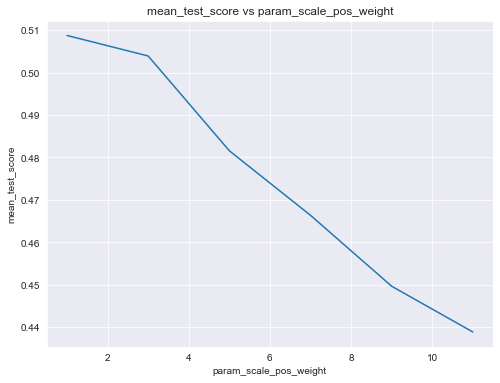

In [80]:
plot_results(final_cv_results, 'param_scale_pos_weight', 'mean_test_score')

In [84]:
# tuning n_estimators for alpha 0.1
params = {'n_estimators':range(100,1100,200)}

grid_search = GridSearchCV(estimator = XGBClassifier( learning_rate =0.1, n_estimators=200, max_depth=7,
                                                  min_child_weight=4, gamma=0, subsample=0.8, colsample_bytree=0.8,
                                                     reg_alpha=1, reg_lambda=0.001,
                                                  objective= 'binary:logistic', n_jobs=-1, scale_pos_weight=1, random_state=27), 
                        param_grid = params, scoring='f1',cv=5, n_jobs = -1, return_train_score = True, verbose = 2)
grid_search.fit(X_train,y_train)
final_cv_results = grid_search.cv_results_
final_cv_results = pd.DataFrame(final_cv_results)
final_cv_results[final_cv_results['rank_test_score'] == 1]

Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  23 out of  25 | elapsed:  2.7min remaining:   14.1s
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:  2.9min finished


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,...,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
1,30.559863,0.873642,0.250778,0.068934,300,{'n_estimators': 300},0.527633,0.51298,0.5,0.512448,...,0.504631,0.01936,1,0.64812,0.647739,0.64336,0.64586,0.654735,0.647963,0.003783


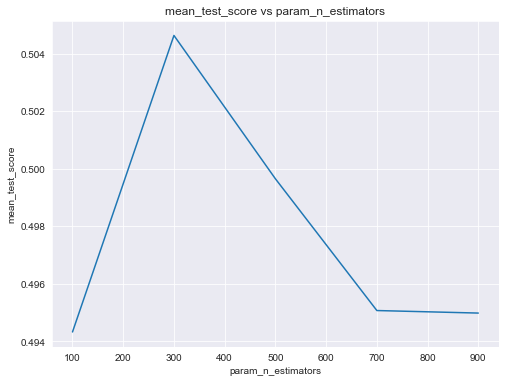

In [85]:
plot_results(final_cv_results, 'param_n_estimators', 'mean_test_score')

In [ ]:
{'colsample_bytree': 0.6,
 'gamma': 0.9,
 'learning_rate': 0.4,
 'max_depth': 5,
 'min_child_weight': 1,
 'n_estimators': 200,
 'reg_alpha': 0.1,
 'reg_lambda': 10,
 'scale_pos_weight': 1,
 'subsample': 1.0}

In [61]:
modelXg= XGBClassifier( learning_rate =0.4, n_estimators=200, max_depth=5,
                                                  min_child_weight=1, gamma=0.9, subsample=1.0, colsample_bytree=0.6,
                                                  objective= 'binary:logistic', n_jobs=-1, scale_pos_weight=1, random_state=27)
modelXg.fit(X_train, y_train)
classification_rep(y_train, X_train, modelXg)
classification_rep(y_test, X_test, modelXg)

The roc_auc score is 0.965
confusion matrix:
[[34983    47]
 [ 1850  1485]]
classification report:
              precision    recall  f1-score   support

           0       0.95      1.00      0.97     35030
           1       0.97      0.45      0.61      3335

    accuracy                           0.95     38365
   macro avg       0.96      0.72      0.79     38365
weighted avg       0.95      0.95      0.94     38365

The roc_auc score is 0.9048
confusion matrix:
[[15019    91]
 [  845   488]]
classification report:
              precision    recall  f1-score   support

           0       0.95      0.99      0.97     15110
           1       0.84      0.37      0.51      1333

    accuracy                           0.94     16443
   macro avg       0.89      0.68      0.74     16443
weighted avg       0.94      0.94      0.93     16443



### Hyperopt

In [60]:
xgb = XGBClassifier()
xgb.fit(X_train,y_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)

In [ ]:
params = {'max_depth':range(3,10),
          'min_child_weight':range(1,9),
          'gamma':[i/10.0 for i in range(0,11)],
          'n_estimators':range(100,1000,100),
          'subsample':[i/10.0 for i in range(6,11)],
          'colsample_bytree':[i/10.0 for i in range(6,11)],
          'reg_alpha':[1e-2, 0.1, 0.4,0.5,0.6,1, 100],
          'reg_lambda':[0.001, 1, 10, 100],
          'scale_pos_weight':range(1,12,2)}


In [62]:
import xgboost as xgb

In [71]:
#Importing necessary libraries
from bayes_opt import BayesianOptimization
import xgboost as xgb
from sklearn.metrics import mean_squared_error

#Converting the dataframe into XGBoost’s Dmatrix object
dtrain = xgb.DMatrix(X_train, label=y_train)

#Bayesian Optimization function for xgboost
#specify the parameters you want to tune as keyword arguments
def bo_tune_xgb(max_depth, gamma, n_estimators ,learning_rate):
    params = {'max_depth': int(max_depth),
               'gamma': gamma,
               'n_estimators': int(n_estimators),
               'learning_rate':learning_rate,
               'eta': 0.1,
               'eval_metric': 'rmse'}
    #Cross validating with the specified parameters in 5 folds and 70 iterations
    cv_result = xgb.cv(params, dtrain, num_boost_round=70, nfold=5)
    #Return the negative RMSE
    return -1.0 * cv_result['test-rmse-mean'].iloc[-1]

#Invoking the Bayesian Optimizer with the specified parameters to tune
xgb_bo = BayesianOptimization(bo_tune_xgb, {'max_depth': (3, 10),
                                            'gamma': (0, 1),
                                            'learning_rate':(0,1),
                                            'n_estimators':(100,500)
                                            })

#performing Bayesian optimization for 5 iterations with 8 steps of random exploration with an #acquisition function of expected improvement
xgb_bo.maximize(n_iter=5, init_points=8, acq='ei')

|   iter    |  target   |   gamma   | learni... | max_depth | n_esti... |
-------------------------------------------------------------------------
|  1        | -0.2363   |  0.000465 |  0.04638  |  5.998    |  228.2    |
|  2        | -0.2277   |  0.1792   |  0.1849   |  9.234    |  429.4    |
|  3        | -0.2311   |  0.9628   |  0.9749   |  8.71     |  396.8    |
|  4        | -0.2263   |  0.6479   |  0.469    |  5.188    |  293.8    |
|  5        | -0.226    |  0.3179   |  0.3459   |  4.658    |  173.6    |
|  6        | -0.2301   |  0.7234   |  0.9748   |  4.517    |  184.0    |
|  7        | -0.2239   |  0.4298   |  0.2299   |  6.732    |  258.6    |
|  8        | -0.2244   |  0.6623   |  0.1544   |  7.215    |  409.9    |
|  9        | -0.2296   |  0.7036   |  0.911    |  3.139    |  100.0    |
|  10       | -0.2316   |  0.9038   |  0.4911   |  3.008    |  500.0    |
|  11       | -0.2242   |  0.9951   |  0.1927   |  9.962    |  139.6    |
|  12       | -0.2427   |  0.9875   | 

In [72]:
#Extracting the best parameters
params = xgb_bo.max['params']
print(params)

{'gamma': 0.4298084292639357, 'learning_rate': 0.22991338743968737, 'max_depth': 6.732417478885573, 'n_estimators': 258.6185470912958}


In [73]:
#Extracting the best parameters
params = xgb_bo.max['params']
print(params)

#Converting the max_depth and n_estimator values from float to int
params['max_depth']= int(params['max_depth'])
params['n_estimators']= int(params['n_estimators'])

#Initialize an XGBClassifier with the tuned parameters and fit the training data
from xgboost import XGBClassifier
classifier2 = XGBClassifier(**params).fit(X_train,y_train)

#predicting for training set
train_p2 = classifier2.predict(X_train)

#Looking at the classification report
print(classification_report(train_p2, y_train))

{'gamma': 0.4298084292639357, 'learning_rate': 0.22991338743968737, 'max_depth': 6.732417478885573, 'n_estimators': 258.6185470912958}
              precision    recall  f1-score   support

           0       1.00      0.95      0.97     36847
           1       0.45      0.98      0.61      1518

    accuracy                           0.95     38365
   macro avg       0.72      0.97      0.79     38365
weighted avg       0.98      0.95      0.96     38365



In [74]:
#predicting for training set
train_p2 = classifier2.predict(X_test)
#Looking at the classification report
print(classification_report(train_p2, y_test))

              precision    recall  f1-score   support

           0       1.00      0.95      0.97     15892
           1       0.36      0.87      0.51       551

    accuracy                           0.94     16443
   macro avg       0.68      0.91      0.74     16443
weighted avg       0.97      0.94      0.95     16443



In [75]:
###Train the model with the best params
modelXg = XGBClassifier(learning_rate=0.3, 
                        n_estimators=300, 
                        max_depth=6, 
                        min_child_weight=2, 
                        gamma=0.8,
                        nthread=4, 
                        subsample=1.0, 
                        colsample_bytree=0.8, 
                        reg_alpha=1,
                        reg_lambda=10,
                        objective= 'binary:logistic',
                        scale_pos_weight=1,
                        seed=29)
# fitting the train data
modelXg.fit(X_train, y_train)
# classification metrics for the train data
classification_rep(y_train, X_train, modelXg)
# Testing the model on the test dataset
classification_rep(y_test, X_test, modelXg)

The roc_auc score is 0.9643
confusion matrix:
[[34974    56]
 [ 1937  1398]]
classification report:
              precision    recall  f1-score   support

           0       0.95      1.00      0.97     35030
           1       0.96      0.42      0.58      3335

    accuracy                           0.95     38365
   macro avg       0.95      0.71      0.78     38365
weighted avg       0.95      0.95      0.94     38365

The roc_auc score is 0.9058
confusion matrix:
[[15046    64]
 [  843   490]]
classification report:
              precision    recall  f1-score   support

           0       0.95      1.00      0.97     15110
           1       0.88      0.37      0.52      1333

    accuracy                           0.94     16443
   macro avg       0.92      0.68      0.75     16443
weighted avg       0.94      0.94      0.93     16443



## Making Predictions

In [76]:
#creating X and y for training entire dataframe
y = df.pop('is_promoted')
X = df

KeyError: 'is_promoted'

In [80]:
#training model on entire dataset
modelXg.fit(X,y)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.8, gamma=0.8,
              learning_rate=0.3, max_delta_step=0, max_depth=6,
              min_child_weight=2, missing=None, n_estimators=300, n_jobs=1,
              nthread=4, objective='binary:logistic', random_state=0,
              reg_alpha=1, reg_lambda=10, scale_pos_weight=1, seed=29,
              silent=None, subsample=1.0, verbosity=1)

In [84]:
res = classifier2.predict(df_test)
sub = pd.read_csv('sample_submission-hr.csv')
sub['is_promoted'] = res
sub.to_csv('aa.csv')

In [82]:
classifier2 = XGBClassifier(**params).fit(X,y)